In [1]:
import torch
import matplotlib.pyplot as plt
from torchvision import transforms
from torch.utils.data import DataLoader

from histopathossl.training.dataset import SuperpixelMoCoDatasetDebug

In [2]:
# Load the dataset
mapping_file = "/home/valentin/workspaces/histolung/data/interim/tiles_superpixels_with_overlap/superpixel_mapping_train.json"
dataset = SuperpixelMoCoDatasetDebug(mapping_file,
                                     num_tiles=8,
                                     transform=transforms.ToTensor())

# DataLoader for batch visualization
batch_size = 16  # Adjust based on how many pairs you want to see
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

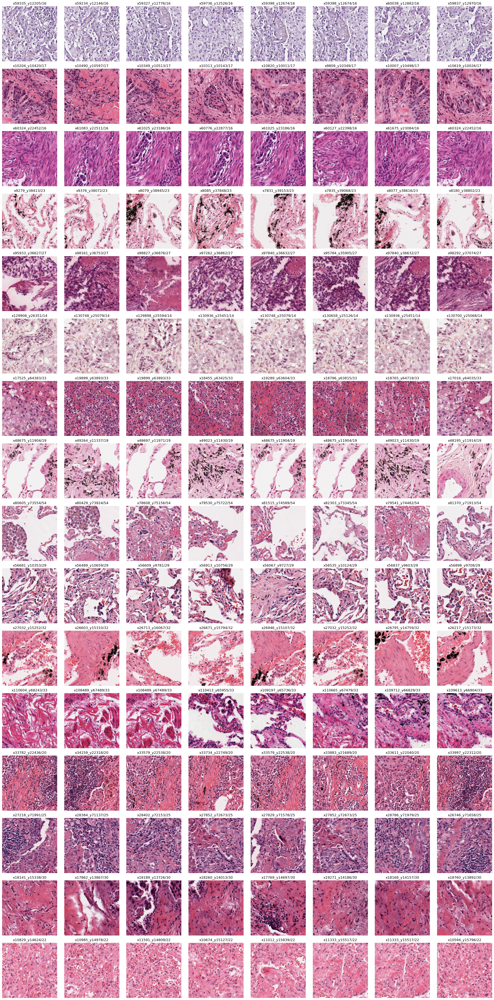

In [3]:
# Get a batch from the dataloader
batch, tile_ids, nb_tiles = next(iter(
    dataloader))  # batch is a list of lists: [[img1, img2, ..., imgN], ...]


# Convert tensors to images
def tensor_to_image(tensor):
    return tensor.permute(1, 2, 0).numpy()  # Convert (C, H, W) -> (H, W, C)


# Create the figure with correct dimensions
fig, axes = plt.subplots(nrows=batch_size,
                         ncols=dataset.num_tiles,
                         figsize=(dataset.num_tiles * 3, batch_size * 3))

# Iterate over batch
for i, tile_set in enumerate(
        batch):  # loop over the tiles from the same superpixel
    for j, img in enumerate(tile_set):  # Iterate over superpixels
        img = tensor_to_image(img)  # Convert to numpy
        axes[j, i].imshow(img)
        # axes[j, i].set_title(f"Superpixel {j+1}, tiles {i+1}")
        axes[j, i].set_title(f"{str(tile_ids[i][j]).split('__')[-1]}/{nb_tiles[j]}")
        axes[j, i].axis("off")

plt.tight_layout()
plt.show()
